<a href="https://colab.research.google.com/github/hidt4/python-compchem-book/blob/main/compchem_book_ch11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 11章 分子どうしの相互作用を計算してみよう

### 環境構築

#### Google Colab上にPsi4をインストール

In [1]:
!wget -c https://repo.continuum.io/miniconda/Miniconda3-latest-Linux-x86_64.sh
!chmod +x Miniconda3-latest-Linux-x86_64.sh
!bash ./Miniconda3-latest-Linux-x86_64.sh -b -f -p /usr/local
!conda install -q -y psi4=1.8 python=3.10 -c conda-forge/label/libint_dev -c conda-forge
import sys
sys.path.append('/usr/local/lib/python3.10/site-packages')

--2024-06-05 12:03:37--  https://repo.continuum.io/miniconda/Miniconda3-latest-Linux-x86_64.sh
Resolving repo.continuum.io (repo.continuum.io)... 104.18.176.84, 104.18.177.84, 2606:4700::6812:b054, ...
Connecting to repo.continuum.io (repo.continuum.io)|104.18.176.84|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://repo.anaconda.com/miniconda/Miniconda3-latest-Linux-x86_64.sh [following]
--2024-06-05 12:03:37--  https://repo.anaconda.com/miniconda/Miniconda3-latest-Linux-x86_64.sh
Resolving repo.anaconda.com (repo.anaconda.com)... 104.16.32.241, 104.16.191.158, 2606:4700::6810:bf9e, ...
Connecting to repo.anaconda.com (repo.anaconda.com)|104.16.32.241|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 143808873 (137M) [application/octet-stream]
Saving to: ‘Miniconda3-latest-Linux-x86_64.sh’

Miniconda3-latest-L 100%[===================>] 137.15M   184MB/s    in 0.7s    

2024-06-05 12:03:38 (184 MB/s) - ‘Miniconda

In [2]:
import os
import datetime
import numpy as np
import pandas as pd
import psi4

print(f'current time: {datetime.datetime.now()}')
print(f'python version:\n{sys.version}')
print(f'numpy version: {np.__version__}')
print(f'pandas version: {pd.__version__}')
print(f'psi4 version: {psi4.__version__}')

current time: 2024-06-05 12:05:56.689540
python version:
3.10.12 (main, Nov 20 2023, 15:14:05) [GCC 11.4.0]
numpy version: 1.25.2
pandas version: 2.0.3
psi4 version: 1.8.2


#### 必要なライブラリと関数の定義

In [ ]:
# 振動数可視化のためのライブラリ
!pip install py3Dmol
import py3Dmol

!git clone https://github.com/duerrsimon/normal-mode-jupyter.git
sys.path.append('/content/normal-mode-jupyter')
from helpers import show_normal_modes

Cloning into 'normal-mode-jupyter'...
remote: Enumerating objects: 23, done.
remote: Counting objects: 100% (23/23), done.
remote: Compressing objects: 100% (19/19), done.
remote: Total 23 (delta 8), reused 17 (delta 4), pack-reused 0
Unpacking objects: 100% (23/23), 801.95 KiB | 772.00 KiB/s, done.


In [ ]:
def show_3D(mol: psi4.core.Molecule) -> py3Dmol.view:
    """
    Psi4のMoleculeオブジェクトをpy3Dmolで描画する
    Args:
        mol: 描画対象の分子

    Returns:
        py3Dmol.view: py3Dmolの描画オブジェクト

    """
    view = py3Dmol.view(width=400, height=400)
    xyz = mol.save_string_xyz_file()
    view.addModel(xyz, 'xyz')
    view.setStyle({'stick': {}})
    view.setBackgroundColor('#e1e1e1')
    view.zoomTo()

    return view.show()

In [ ]:
def optfreq(mol: psi4.core.Molecule,
            theory: str) -> list[float, psi4.core.Wavefunction]:
    """
    分子の構造最適化と振動数計算を行う

    Args:
        mol (psi4.core.Molecule): 計算対象の分子
        theory: 計算レベル

    Returns:
        float: エネルギー
        psi4.core.Wavefunction: 計算のWavefunction

    """
    _, wfn = psi4.optimize(theory,
                           molecule=mol,
                           return_wfn=True)
    energy, wfn = psi4.frequency(theory,
                                 molecule=mol,
                                 ref_gradient=wfn.gradient(),
                                 return_wfn=True)

    return [energy, wfn]


def get_freqs(wavefunction: psi4.core.Wavefunction) -> np.ndarray:
    """
    Wavefunctionオブジェクトから振動数を取り出す
    Args:
        wavefunction: 対象のWavefunctionオブジェクト

    Returns:
        振動数のarrray

    """
    return wavefunction.frequencies().to_array()


#### 計算資源の設定

In [ ]:
# 計算資源の確認（CPU, RAM）
!cat /proc/cpuinfo

processor	: 0
vendor_id	: GenuineIntel
cpu family	: 6
model		: 79
model name	: Intel(R) Xeon(R) CPU @ 2.20GHz
stepping	: 0
microcode	: 0xffffffff
cpu MHz		: 2199.998
cache size	: 56320 KB
physical id	: 0
siblings	: 8
core id		: 0
cpu cores	: 4
apicid		: 0
initial apicid	: 0
fpu		: yes
fpu_exception	: yes
cpuid level	: 13
wp		: yes
flags		: fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 clflush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc rep_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3 fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand hypervisor lahf_lm abm 3dnowprefetch invpcid_single ssbd ibrs ibpb stibp fsgsbase tsc_adjust bmi1 hle avx2 smep bmi2 erms invpcid rtm rdseed adx smap xsaveopt arat md_clear arch_capabilities
bugs		: cpu_meltdown spectre_v1 spectre_v2 spec_store_bypass l1tf mds swapgs taa mmio_stale_data retbleed
bogomips	: 4399.99
clflush size	: 64
cache_alignment	: 64
addres

In [ ]:
!cat /proc/meminfo

MemTotal:       53474556 kB
MemFree:        40092220 kB
MemAvailable:   51816324 kB
Buffers:          219348 kB
Cached:         11661692 kB
SwapCached:            0 kB
Active:          1270108 kB
Inactive:       11329668 kB
Active(anon):       1212 kB
Inactive(anon):   719020 kB
Active(file):    1268896 kB
Inactive(file): 10610648 kB
Unevictable:           0 kB
Mlocked:               0 kB
SwapTotal:             0 kB
SwapFree:              0 kB
Dirty:            177240 kB
Writeback:             0 kB
AnonPages:        715616 kB
Mapped:           448392 kB
Shmem:              1480 kB
KReclaimable:     473320 kB
Slab:             557404 kB
SReclaimable:     473320 kB
SUnreclaim:        84084 kB
KernelStack:        6144 kB
PageTables:        16012 kB
NFS_Unstable:          0 kB
Bounce:                0 kB
WritebackTmp:          0 kB
CommitLimit:    26737276 kB
Committed_AS:    2909420 kB
VmallocTotal:   34359738367 kB
VmallocUsed:       10176 kB
VmallocChunk:          0 kB
Percpu:          

In [ ]:
n_cpu = os.cpu_count()
ram = os.sysconf('SC_PAGE_SIZE') * os.sysconf('SC_PHYS_PAGES') / (1024 ** 3)

In [ ]:
# 環境に応じて計算資源を設定
psi4.set_num_threads(n_cpu)
psi4.set_memory(f'{ram * 0.9: .0f}GB')

46000000000

### 超分子法

#### 水二量体

In [ ]:
water_dimer = psi4.geometry('''
0 1
 O                  1.41038900   -0.12125100   -0.03877600
 H                  1.57876400    0.65723900   -0.59380500
 H                  1.58039200    0.18907100    0.86523600
 --
0 1
 H                 -0.54699100   -0.10878800   -0.03565200
 O                 -1.49308500    0.11629300    0.03640700
 H                 -1.95060200   -0.69785800   -0.21683100
 ''')

psi4.set_output_file('water_dimer.log')

PosixPath('water_dimer.log')

In [ ]:
e_dimer, wfn_dimer = optfreq(water_dimer, theory='mp2/cc-pvtz')

INFO:psi4.optking.optwrapper:Creating a UserComputer
INFO:psi4.optking.optwrapper:
    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
INFO:psi4.optking.optwrapper:
		 -- Optimization Parameters --
	accept_symmetry_breaking       =           False
	alg_geom_maxiter               =              50
	bt_dx_conv                     =           1e-07
	bt_dx_rms_change_conv          =           1e-12
	bt_max_iter                    =              25
	cart_hess_read                 =           False
	consecutive_backsteps_allowed  =               0
	conv_max_DE                    =           1e-06
	conv_max_disp                  =          0.0012
	conv_max_force                 =          0.0003
	conv_rms_disp                  =              -1

Optimizer: Optimization complete!


INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1e-10, 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'C1', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvtz, molecule=H4O2, nre=36.76438397382657
INFO:psi4.driver.driver:Return gradient(): -152.67439691015463
INFO:psi4.driver.driver:[[ 0.00003682 -0.00002213  0.00001090]
 [ 0.00000279  0.00001546 -0.00001040]
 [ 0.00001824  0.00000534  0.00001186]
 [-0.00010365  0.00000764 -0.00002170]
 [ 0.00004146 -0.00002106  0.00000431]
 [ 0.00000433  0.00001475  0.00000502]]
INFO:psi4.driver.task_base:<<< JSON launch ... c1 36.76665621076671
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1e-10, 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'C1', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-p

In [ ]:
show_3D(water_dimer)

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [ ]:
print(get_freqs(wfn_dimer))

[  118.3267503027032461   143.7412654164248806   149.3252328721535775
   187.5382896634987446   375.9742322774889089   653.9633433210241265
  1646.2497431449316991  1679.2759062488855761  3784.6617003115602529
  3855.8228283014632325  3960.5652449502554191  3974.9375529821054442]


#### 水単量体

In [ ]:
water_monomer = psi4.geometry('''
0 1
 O                  1.41038900   -0.12125100   -0.03877600
 H                  1.57876400    0.65723900   -0.59380500
 H                  1.58039200    0.18907100    0.86523600
''')

psi4.set_output_file('water_monomer.log')

PosixPath('water_monomer.log')

In [ ]:
e_monomer, wfn_monomer = optfreq(water_monomer, theory='mp2/cc-pvtz')

INFO:psi4.optking.optwrapper:Creating a UserComputer
INFO:psi4.optking.optwrapper:
    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
INFO:psi4.optking.optwrapper:
		 -- Optimization Parameters --
	accept_symmetry_breaking       =           False
	alg_geom_maxiter               =              50
	bt_dx_conv                     =           1e-07
	bt_dx_rms_change_conv          =           1e-12
	bt_max_iter                    =              25
	cart_hess_read                 =           False
	consecutive_backsteps_allowed  =               0
	conv_max_DE                    =           1e-06
	conv_max_disp                  =          0.0012
	conv_max_force                 =          0.0003
	conv_rms_disp                  =              -1

Optimizer: Optimization complete!


INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1e-10, 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'CS(Z)', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvtz, molecule=H2O, nre=9.192878391975587
INFO:psi4.driver.driver:Return gradient(): -76.33219689073907
INFO:psi4.driver.driver:[[ 0.00018651  0.00005744  0.00000000]
 [-0.00009706 -0.00001620  0.00000000]
 [-0.00008945 -0.00004124  0.00000000]]
INFO:psi4.driver.task_base:<<< JSON launch ... cs 9.20384340945721
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1e-10, 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'CS(Z)', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvtz, molecule=H2O, nre=9.20384340945721
INFO:psi4.driver.driver:Return gradient(): -76.33219408022515
INFO:psi4.dr

In [ ]:
print(get_freqs(wfn_monomer))

[ 1651.1141377039893996  3870.6939714213240222  3991.6227829198660402]


In [ ]:
show_3D(water_monomer)

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

#### 超分子法による相互作用エネルギーの計算

In [ ]:
au2kcal = psi4.constants.hartree2kcalmol

e_int = e_dimer - 2 * e_monomer
print(f'interaction energy: {au2kcal * e_int: .2f} kcal/mol')

interaction energy: -6.28 kcal/mol


### CP法

In [ ]:
psi4.set_output_file('water_dimer_cp.log')

PosixPath('water_dimer_cp.log')

In [ ]:
e_cp = psi4.energy('mp2/cc-pvtz',
                   bsse_type='cp',
                   molecule=water_dimer)

INFO:psi4.driver.task_planner:PLANNING MB:  mc_level_idx=0 packet={'driver': 'energy', 'method': 'mp2', 'basis': 'cc-pvtz', 'keywords': {'SCF__INTS_TOLERANCE': 1e-12, 'function_kwargs': {}}}
INFO:psi4.driver.driver_nbody:
  //>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>//
  // ManyBody Setup: N-Body Levels [1, 2]//
  //<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<//


INFO:psi4.driver.driver_nbody:        Number of 1-body computations:     2
        Number of 2-body computations:     1
INFO:psi4.driver.driver_nbody:
  //>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>//
  //       ManyBody Computations       //
  //<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<//


INFO:psi4.driver.task_base:<<< JSON launch ... c1 9.166549515456863
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__INTS_TOLERANCE': 1e-12, 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=mp2, basis=cc-pvtz, molecule=H4O2, nre=9.166549515456863
INFO:psi4.driver.driver:Return energy(): -76.33286439541557
INFO:psi4.driver.tas

In [ ]:
print(f'CP corrected interaction energy: {au2kcal * e_cp: .2f} kcal/mol')

CP corrected interaction energy: -4.40 kcal/mol


In [ ]:
# BSSEの算出
print(f'BSSE at MP2/cc-pVTZ level: {au2kcal * (e_cp - e_int): .2f} kcal/mol')

BSSE at MP2/cc-pVTZ level:  1.88 kcal/mol


### 基底関数系とBSSEの関係

In [ ]:
def get_intE(monomer: psi4.core.Molecule, dimer: psi4.core.Molecule, theory: str) -> list[float, float, float]:
    """
    相互作用エネルギーを見積もる
    Args:
        monomer: 単量体
        dimer: 二量体
        theory: 計算レベル

    Returns:
        float: 超分子法により推定した相互作用エネルギー
        float: CP法により補正した相互作用エネルギー
        float: BSSE

    """
    au2kcal = psi4.constants.hartree2kcalmol
    energy_monomer = psi4.energy(theory, molecule=monomer)
    energy_dimer = psi4.energy(theory, molecule=dimer)
    energy_cp = psi4.energy(theory, bsse_type='cp', molecule=dimer)

    int_supermol = au2kcal * (energy_dimer - 2 * energy_monomer)
    int_cp = au2kcal * energy_cp
    bsse = int_cp - int_supermol

    return [int_supermol, int_cp, bsse]

In [ ]:
hf = pd.DataFrame()
mp2 = pd.DataFrame()
basis_sets = ['sto-3g', 'cc-pvdz', 'cc-pvtz', 'aug-cc-pvtz', 'aug-cc-pvqz', 'aug-cc-pv5z']

In [ ]:
psi4.set_output_file('basis-set-bsse.log')

PosixPath('basis-set-bsse.log')

In [ ]:
for basis_set in basis_sets:
    hf_theory = f'hf/{basis_set}'
    mp2_theory = f'mp2/{basis_set}'

    hf[hf_theory] = get_intE(monomer=water_monomer,
                             dimer=water_dimer,
                             theory=hf_theory)
    mp2[mp2_theory] = get_intE(monomer=water_monomer,
                               dimer=water_dimer,
                               theory=mp2_theory)

INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__INTS_TOLERANCE': 1e-12, 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=hf, basis=sto-3g, molecule=default, nre=9.192878391975587
INFO:psi4.driver.driver:Return energy(): -74.96332793977697
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__INTS_TOLERANCE': 1e-12, 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=hf, basis=sto-3g, molecule=default, nre=36.76438397382657
INFO:psi4.driver.driver:Return energy(): -149.93590808693324
INFO:psi4.driver.task_planner:PLANNING MB:  mc_level_idx=0 packet={'driver': 'energy', 'method': 'hf', 'basis': 'sto-3g', 'keywords': {'SCF__INTS_TOLERANCE': 1e-12, 'function_kwargs': {}}}
INFO:psi4.driver.driver_nbody:
  //>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>//
  // ManyBody Setup: N-Body Levels [1, 2]//
  //<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<//


INFO:psi4.driver.driver_nbody:        Number of 1-body computations:     2
        Number

In [ ]:
hf.round(2)

,hf/sto-3g,hf/cc-pvdz,hf/cc-pvtz,hf/aug-cc-pvtz,hf/aug-cc-pvqz,hf/aug-cc-pv5z
0,-5.81,-5.60,-4.16,-3.39,-3.36,-3.33
1,-1.27,-3.57,-3.47,-3.46,-3.50,-3.50
2,4.53,2.02,0.69,-0.08,-0.14,-0.17


In [ ]:
mp2.round(2)

,mp2/sto-3g,mp2/cc-pvdz,mp2/cc-pvtz,mp2/aug-cc-pvtz,mp2/aug-cc-pvqz,mp2/aug-cc-pv5z
0,-6.45,-7.44,-6.28,-5.61,-5.18,-5.16
1,-1.01,-3.84,-4.40,-4.66,-4.85,-4.90
2,5.44,3.60,1.88,0.94,0.33,0.26


### 歪曲・相互作用モデル

In [ ]:
au2kcal = psi4.constants.hartree2kcalmol

In [ ]:
theory = 'mp2/cc-pvtz'

bf3 = psi4.geometry('''
0 1
 B                 -0.46887968    0.02074689    0.00000000
 F                 -1.19887968   -1.24365020    0.00000000
 F                  0.99112032    0.02074689    0.00000000
 F                 -1.19887968    1.28514398    0.00000000
 ''')

nh3 = psi4.geometry('''
0 1
 N                  0.10373444   -0.31950207    0.00000000
 H                  0.43705633   -1.26231516    0.00000000
 H                  0.43707354    0.15189811    0.81649673
 H                  0.43707354    0.15189811   -0.81649673
 ''')

In [ ]:
bf3_nh3 = psi4.geometry('''
0 1
 B                 -0.46887968    0.02074689    0.00000000
 F                 -1.15713027   -1.17133812   -0.48666667
 F                  0.90762153    0.02074689   -0.48666666
 F                 -1.15713027    1.21283190   -0.48666667
--
0 1
 N                 -0.46887968    0.02074689    1.58000000
 H                  0.00252447    0.83724368    1.91333334
 H                 -1.41168872    0.02074647    1.91333333
 H                  0.00252520   -0.79574948    1.91333334
''')

#### BF3

In [ ]:
psi4.set_output_file('bf3.log')
e_bf3, wfn_bf3 = optfreq(bf3, theory=theory)

INFO:psi4.optking.optwrapper:Creating a UserComputer
INFO:psi4.optking.optwrapper:
    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
INFO:psi4.optking.optwrapper:
		 -- Optimization Parameters --
	accept_symmetry_breaking       =           False
	alg_geom_maxiter               =              50
	bt_dx_conv                     =           1e-07
	bt_dx_rms_change_conv          =           1e-12
	bt_max_iter                    =              25
	cart_hess_read                 =           False
	consecutive_backsteps_allowed  =               0
	conv_max_DE                    =           1e-06
	conv_max_disp                  =          0.0012
	conv_max_force                 =          0.0003
	conv_rms_disp                  =              -1

Optimizer: Optimization complete!


INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1e-10, 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'C2V(Z)', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvtz, molecule=BF3, nre=111.12307182428295
INFO:psi4.driver.driver:Return gradient(): -324.218686563785
INFO:psi4.driver.driver:[[ 0.00000000  0.00000000 -0.00000000]
 [ 0.00000000 -0.00000000  0.00016785]
 [-0.00014536 -0.00000000 -0.00008393]
 [ 0.00014536  0.00000000 -0.00008393]]
INFO:psi4.driver.task_base:<<< JSON launch ... c2v 111.12307784830435
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1e-10, 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'C2V(Z)', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvtz, molecule=BF3, nre=111.12307784830436
INFO:psi4.driver.driver:Retu

In [ ]:
print(get_freqs(wfn_bf3))

[  484.0589878663377590   484.0590512131576020   703.2215802423897912
   900.0725677036119805  1490.5559245614385873  1490.5559414015833681]


In [ ]:
show_3D(bf3)

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

#### NH3

In [ ]:
psi4.set_output_file('nh3.log')
e_nh3, wfn_nh3 = optfreq(nh3, theory=theory)

INFO:psi4.optking.optwrapper:Creating a UserComputer
INFO:psi4.optking.optwrapper:
    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
INFO:psi4.optking.optwrapper:
		 -- Optimization Parameters --
	accept_symmetry_breaking       =           False
	alg_geom_maxiter               =              50
	bt_dx_conv                     =           1e-07
	bt_dx_rms_change_conv          =           1e-12
	bt_max_iter                    =              25
	cart_hess_read                 =           False
	consecutive_backsteps_allowed  =               0
	conv_max_DE                    =           1e-06
	conv_max_disp                  =          0.0012
	conv_max_force                 =          0.0003
	conv_rms_disp                  =              -1

Optimizer: Optimization complete!


INFO:psi4.driver.task_base:<<< JSON launch ... cs 11.998930732695818
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1e-10, 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'CS(Z)', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvtz, molecule=H3N, nre=11.998930732695818
INFO:psi4.driver.driver:Return gradient(): -56.46779860145061
INFO:psi4.driver.driver:[[ 0.00000000  0.00001932  0.00000000]
 [ 0.00000014 -0.00000644  0.00000025]
 [ 0.00000014 -0.00000644 -0.00000025]
 [-0.00000028 -0.00000644  0.00000000]]
INFO:psi4.driver.task_base:<<< JSON launch ... cs 11.998940827834483
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1e-10, 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'CS(Z)', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvtz

In [ ]:
print(get_freqs(wfn_nh3))

[ 1078.1518251336606227  1691.7360049507537951  1691.7424624493455667
  3536.9935989489358690  3675.6313679239583507  3675.6410912722053581]


In [ ]:
show_3D(nh3)

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

#### BF3-NH3 complex

In [ ]:
psi4.set_output_file('bf3-nh3.log')
_, wfn_complex = optfreq(bf3_nh3, theory=theory)

INFO:psi4.optking.optwrapper:Creating a UserComputer
INFO:psi4.optking.optwrapper:
    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
INFO:psi4.optking.optwrapper:
		 -- Optimization Parameters --
	accept_symmetry_breaking       =           False
	alg_geom_maxiter               =              50
	bt_dx_conv                     =           1e-07
	bt_dx_rms_change_conv          =           1e-12
	bt_max_iter                    =              25
	cart_hess_read                 =           False
	consecutive_backsteps_allowed  =               0
	conv_max_DE                    =           1e-06
	conv_max_disp                  =          0.0012
	conv_max_force                 =          0.0003
	conv_rms_disp                  =              -1

Optimizer: Optimization complete!


INFO:psi4.driver.task_base:<<< JSON launch ... c1 191.80810016238513
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1e-10, 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'C1', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvtz, molecule=BF3H3N, nre=191.80810016238513
INFO:psi4.driver.driver:Return gradient(): -380.72507650324667
INFO:psi4.driver.driver:[[-0.00007188  0.00000000  0.00000000]
 [ 0.00000125 -0.00000139 -0.00000241]
 [ 0.00000125 -0.00000139  0.00000241]
 [ 0.00000125  0.00000278  0.00000000]
 [ 0.00014049 -0.00000000 -0.00000000]
 [-0.00002412  0.00000354  0.00000613]
 [-0.00002412  0.00000354 -0.00000613]
 [-0.00002412 -0.00000708  0.00000000]]
INFO:psi4.driver.task_base:<<< JSON launch ... c1 191.8070803873449
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1

In [ ]:
print(get_freqs(wfn_complex))

[  171.6112445614049307   282.6547602609360865   282.6550797075301489
   455.5769790266650716   455.5773220833356163   462.3528408447009497
   691.0301785412904110   817.0236649140249483   817.0244556064450308
   909.2995625503173187  1279.7279809174287948  1279.7281896307360967
  1333.4924655958525364  1670.7039341481231531  1670.7050092674608095
  3516.8756968114139454  3650.1346183096666209  3650.1396034285494352]


In [ ]:
show_3D(bf3_nh3)

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [ ]:
print(bf3_nh3.save_string_xyz_file())

8

 B    0.125118225065   -0.000000000094    0.000000000448
 F    0.455918039144   -0.662711021999   -1.147849156716
 F    0.455918029036   -0.662711021999    1.147849160593
 F    0.455918039229    1.325422040404    0.000000002150
 N   -1.545025507573    0.000000003927   -0.000000006755
 H   -1.894344093708    0.474567048653    0.821974219771
 H   -1.894344086575    0.474567045442   -0.821974238092
 H   -1.894344093605   -0.949134079890   -0.000000006340



In [ ]:
# CP法
e_cp = psi4.energy(theory, bsse_type='cp', molecule=bf3_nh3)

INFO:psi4.driver.task_planner:PLANNING MB:  mc_level_idx=0 packet={'driver': 'energy', 'method': 'mp2', 'basis': 'cc-pvtz', 'keywords': {'SCF__INTS_TOLERANCE': 1e-12, 'function_kwargs': {}}}
INFO:psi4.driver.driver_nbody:
  //>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>//
  // ManyBody Setup: N-Body Levels [1, 2]//
  //<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<//


INFO:psi4.driver.driver_nbody:        Number of 1-body computations:     2
        Number of 2-body computations:     1
INFO:psi4.driver.driver_nbody:
  //>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>//
  //       ManyBody Computations       //
  //<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<//


INFO:psi4.driver.task_base:<<< JSON launch ... c1 11.953420234158012
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__INTS_TOLERANCE': 1e-12, 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=mp2, basis=cc-pvtz, molecule=BF3H3N, nre=11.953420234158012
INFO:psi4.driver.driver:Return energy(): -56.47241681209107
INFO:psi4.driver

In [ ]:
print(f'interaction energy: {au2kcal * e_cp: .2f} kcal/mol')

interaction energy: -42.22 kcal/mol


##### 歪みエネルギーの算出

In [ ]:
bf3_complex = ''
nh3_complex = ''

for i, line in enumerate(bf3_nh3.save_string_xyz().split('\n')):
    if i < 5:
        bf3_complex += line + '\n'
    elif i == 5:
        nh3_complex += '0 1\n'
        nh3_complex += line + '\n'
    else:
        nh3_complex += line + '\n'

bf3_complex = psi4.geometry(bf3_complex)
nh3_complex = psi4.geometry(nh3_complex)

In [ ]:
print(bf3_complex.save_string_xyz())

0 1
 B   -0.277246364506    0.000000000925   -0.000000001308
 F    0.053553449573   -0.662711020980   -1.147849158472
 F    0.053553439465   -0.662711020980    1.147849158837
 F    0.053553449658    1.325422041423    0.000000000394



In [ ]:
print(nh3_complex.save_string_xyz())

0 1
 N    0.062029952894   -0.000000000143    0.000000000260
 H   -0.287288633241    0.474567044583    0.821974226786
 H   -0.287288626108    0.474567041372   -0.821974231077
 H   -0.287288633138   -0.949134083960    0.000000000675



In [ ]:
psi4.set_output_file('bf3_complex.log')
e_bf3_complex = psi4.energy(theory, molecule=bf3_complex)

INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__INTS_TOLERANCE': 1e-12, 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=mp2, basis=cc-pvtz, molecule=default, nre=108.30835056581218
INFO:psi4.driver.driver:Return energy(): -324.18106093722054


In [ ]:
psi4.set_output_file('nh3_complex.log')
e_nh3_complex = psi4.energy(theory, molecule=nh3_complex)

INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__INTS_TOLERANCE': 1e-12, 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=mp2, basis=cc-pvtz, molecule=default, nre=11.953420234158118
INFO:psi4.driver.driver:Return energy(): -56.46743064785751


In [ ]:
energy_strain = au2kcal * (e_bf3_complex + e_nh3_complex - e_bf3 - e_nh3)
energy_int = au2kcal * e_cp
print(f'strain energy: {energy_strain: .2f} kcal/mol')
print(f'interaction energy: {energy_int: .2f} kcal/mol')
print(f'stagilized energy: {energy_strain + energy_int: .2f} kcal/mol')

strain energy:  23.84 kcal/mol
interaction energy: -42.22 kcal/mol
stagilized energy: -18.38 kcal/mol


### SAPT計算

In [ ]:
# SAPT計算用の設定
psi4.set_options({'SCF_TYPE': 'DF',
                  'FREEZE_CORE': True,
                  'GUESS': 'SAD'})

In [ ]:
def get_SAPT_energies() -> list[float, float, float, float, float]:
    """
    psi4.variableからSAPT計算の結果を取得してkcal/mol単位で返す

    Returns:
        float: 静電力による寄与
        float: 交換反発力による寄与
        float: 誘起力による寄与
        float: 分散力による寄与
        float: 相互作用エネルギー合計

    """
    au2kcal = psi4.constants.hartree2kcalmol
    elst_energy = psi4.variable('SAPT ELST ENERGY') * au2kcal
    exch_energy = psi4.variable('SAPT EXCH ENERGY') * au2kcal
    ind_energy = psi4.variable('SAPT IND ENERGY') * au2kcal
    disp_energy = psi4.variable('SAPT DISP ENERGY') * au2kcal
    sapt_energy = psi4.variable('SAPT TOTAL ENERGY') * au2kcal

    return [elst_energy, exch_energy, ind_energy, disp_energy, sapt_energy]

In [ ]:
def print_SAPT_results(sapt_level: str = 'SAPT0'):
    """
    SAPT計算の結果を出力する

    """
    elst, exch, ind, disp, sapt = get_SAPT_energies()

    print(f'{sapt_level}')
    print(f'SAPT energy: {sapt: .2f}')
    print('--------------------')
    print(f'Electrostatic term: {elst: .2f}')
    print(f'Exchange term: {exch: .2f}')
    print(f'Induction term: {ind: .2f}')
    print(f'Dispersion term: {disp: .2f}')

#### 塩化ナトリウム

In [ ]:
NaCl = psi4.geometry('''
1 1
 Na                -0.62895053    0.30693975    0.00000000
--
-1 1
 Cl                 2.37072890    0.35079471    0.00000000
 ''')

In [ ]:
psi4.set_output_file('NaCl.log')
_, wfn_NaCl = optfreq(NaCl, 'mp2/cc-pvdz')

INFO:psi4.optking.optwrapper:Creating a UserComputer
INFO:psi4.optking.optwrapper:
    			-----------------------------------------

    			 OPTKING 3.0: for geometry optimizations 

    			     By R.A. King, Bethel University     

    			        with contributions from          

    			    A.V. Copan, J. Cayton, A. Heide      

    			-----------------------------------------

    
INFO:psi4.optking.optwrapper:
		 -- Optimization Parameters --
	accept_symmetry_breaking       =           False
	alg_geom_maxiter               =              50
	bt_dx_conv                     =           1e-07
	bt_dx_rms_change_conv          =           1e-12
	bt_max_iter                    =              25
	cart_hess_read                 =           False
	consecutive_backsteps_allowed  =               0
	conv_max_DE                    =           1e-06
	conv_max_disp                  =          0.0012
	conv_max_force                 =          0.0003
	conv_rms_disp                  =              -1

Optimizer: Optimization complete!


INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1e-10, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'C2V(Z)', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvdz, molecule=ClNa, nre=41.185225198579786
INFO:psi4.driver.driver:Return gradient(): -621.5747531364681
INFO:psi4.driver.driver:[[-0.00000000 -0.00000000  0.00001668]
 [ 0.00000000  0.00000000 -0.00001668]]
INFO:psi4.driver.task_base:<<< JSON launch ... c2v 41.173051181062625
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SCF__E_CONVERGENCE': 1e-10, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'C2V(Z)', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvdz, molecule=ClNa, nre=41.17305118106

In [ ]:
print(get_freqs(wfn_NaCl))

[ 352.2319022674564053]


In [ ]:
# SAPT計算
psi4.energy('sapt0/jun-cc-pvdz', molecule=NaCl)
print_SAPT_results()

INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=sapt0, basis=jun-cc-pvdz, molecule=default, nre=41.185225198579786
INFO:psi4.driver.driver:Return energy(): -0.20183667415527515


SAPT0
SAPT energy: -126.65
--------------------
Electrostatics term: -142.31
Exchange term:  25.33
Induction term: -9.56
Dispersion term: -0.11


#### リチウムとベンゼン

In [ ]:
Li_benzene = psi4.geometry('''
0 1
 C                 -0.42021926   -1.46772227    0.00000000
 C                  0.97494074   -1.46772227    0.00000000
 C                  1.67247874   -0.25997127    0.00000000
 C                  0.97482474    0.94853773   -0.00119900
 C                 -0.42000026    0.94845973   -0.00167800
 C                 -1.11760126   -0.25974627   -0.00068200
 H                 -0.96997826   -2.42003927    0.00045000
 H                  1.52444874   -2.42023527    0.00131500
 H                  2.77215874   -0.25989127    0.00063400
 H                  1.52502474    1.90068073   -0.00125800
 H                 -0.97012226    1.90074073   -0.00263100
 H                 -2.21720526   -0.25956327   -0.00086200
 --
 1 1
 Li                 0.35180857   -0.32725870    3.23341003
''')

In [ ]:
psi4.set_output_file('Li-benzene.log')

PosixPath('Li-benzene.log')

In [ ]:
_, wfn_Li = optfreq(Li_benzene, 'mp2/cc-pvdz')

Streaming output truncated to the last 5000 lines.
	  -0.000657   0.000888   0.009930   0.000101   0.000064  -0.000699  -0.000717
	   0.000363  -0.000192  -0.000482   0.000612   0.000364  -0.001366  -0.000906
	   0.001270  -0.004011  -0.003211   0.003797  -0.001560   0.000685   0.001908
	  -0.001333  -0.006666   0.001767   0.000967  -0.004295  -0.000858   0.001341
	  -0.001490   0.009155   0.002058   0.007212   0.000547  -0.003275   0.001879
	   0.003798  -0.002119   0.001318  -0.000267  -0.000253   0.002141
	   0.000142   0.001327   0.000387   0.000454   0.000354   0.002294   0.000921
	   0.000393   0.001552   0.000404   0.001957   0.000526   0.000380   0.000643
	  -0.000064   0.004083   0.000175   0.000025  -0.000329   0.000375   0.000055
	   0.000332  -0.000611  -0.000943  -0.000014   0.000157  -0.000428  -0.000520
	   0.000169  -0.000166  -0.000191  -0.000119   0.000341   0.004316   0.000798
	   0.003016   0.000619  -0.000120  -0.001805  -0.001982  -0.001979   0.000656
	   0.001097

Optimizer: Optimization complete!


INFO:psi4.driver.task_base:<<< JSON launch ... c1 227.52882490783603
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'DF_INTS_IO': 'NONE', 'SAPT__D_CONVERGENCE': 1e-09, 'SCF__D_CONVERGENCE': 1e-10, 'E_CONVERGENCE': 1e-08, 'SAPT__E_CONVERGENCE': 1e-09, 'SCF__E_CONVERGENCE': 1e-10, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'C1', 'SAPT__SAPT_LEVEL': 'SAPT0', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvdz, molecule=C6H6Li, nre=227.52882490783603
INFO:psi4.driver.driver:Return gradient(): -238.80319836768004
INFO:psi4.driver.driver:[[-0.00000131  0.00000789 -0.00000447]
 [ 0.00000053  0.00001197 -0.00010183]
 [ 0.00000563 -0.00000574  0.00000182]
 [-0.00000002 -0.00000229  0.00002016]
 [ 0.00001824 -0.00002475  0.00002926]
 [-0.00000171 -0.00000613  0.00003743]
 [ 0.00000870 -0.00000544  0.00000807]
 [ 0.00000168 -0.00000528  0.00004688]
 [-0.00000171 -0.00000890  0.00000164]

 '604.7503']


In [ ]:
print(get_freqs(wfn_Li))

[  244.0265947866204783   244.0509779379342490   365.5740053615075453
   405.6592641907868142   405.6671775745162449   604.7479482171852396
   604.7503431445927617   676.0932210505404782   743.7607934154922305
   906.6409318853981176   906.6511368660911785   995.7236918729246327
   995.7529893998297439   999.4936754525475635  1007.7221930751278478
  1015.5823141790181126  1052.0088061035310147  1052.0271620248418003
  1174.1144651871547921  1195.6525868661485674  1195.7113761208711367
  1359.2105786358608839  1441.9029854748066555  1492.2612954379837902
  1492.2991667318181044  1619.5256784592040731  1619.5492200979340396
  3230.6287741535775240  3238.9049253176540333  3238.9652856775605869
  3250.6158720828921105  3250.6702504160839453  3256.8279490990726117]


In [ ]:
# SAPT計算
psi4.energy('sapt0/jun-cc-pvdz', molecule=Li_benzene)
print_SAPT_results()

INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'DF_INTS_IO': 'NONE', 'SAPT__D_CONVERGENCE': 1e-09, 'SAPT__E_CONVERGENCE': 1e-09, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'SAPT__SAPT_LEVEL': 'SAPT0', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=sapt0, basis=jun-cc-pvdz, molecule=default, nre=227.52882490783603
INFO:psi4.driver.driver:Return energy(): -0.060838754726368675


SAPT0
SAPT energy: -38.18
--------------------
Electrostatics term: -19.37
Exchange term:  10.48
Induction term: -28.89
Dispersion term: -0.40


#### 水二量体

In [ ]:
def record_elapsed_time(theory: str, molecule: psi4.core.Molecule) -> float:
    """
    指定メソッドでエネルギー計算を行い，実行にかかった時間を返す
    Args:
        theory: 計算レベル
        molecule: 計算対象の分子

    Returns:
        float: 計算にかかった時間（秒）

    """
    import time
    start = time.time()
    psi4.energy(theory, molecule=molecule)
    end = time.time()

    return end - start

In [ ]:
# 水二量体
water_dimer = psi4.geometry('''
0 1
 O    1.412128481591   -0.092045390825   -0.029906791666
 H    1.719638124602    0.616275423632   -0.598773926023
 H    1.722516776196    0.155785589195    0.843086003713
 --
0 1
 H   -0.525178885277   -0.028828516343   -0.009223430301
 O   -1.480679643058    0.092866715086    0.030210284186
 H   -1.829019336855   -0.756267508525   -0.239905293928
''')

In [ ]:
# SAPT0/jun-cc-pvdzレベル
psi4.set_output_file('SAPT0_water_dimer.log')
sapt0_time = record_elapsed_time('sapt0/jun-cc-pvdz', water_dimer)

print(f'SAPT0: {sapt0_time: .2f} sec')
print_SAPT_results('SAPT0')

INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'DF_INTS_IO': 'NONE', 'SAPT__D_CONVERGENCE': 1e-09, 'SAPT__E_CONVERGENCE': 1e-09, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'SAPT__SAPT_LEVEL': 'SAPT0', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=sapt0, basis=jun-cc-pvdz, molecule=default, nre=36.764383989923935
INFO:psi4.driver.driver:Return energy(): -0.007998360803809789


SAPT0:  3.91 sec
SAPT0
SAPT energy: -5.02
--------------------
Electrostatics term: -9.05
Exchange term:  7.56
Induction term: -2.21
Dispersion term: -1.32


In [ ]:
# sSAPT0/jun-cc-pvdzレベル
psi4.set_output_file('sSAPT_water_dimer.log')
ssapt0_time = record_elapsed_time('ssapt0/jun-cc-pvdz', water_dimer)

print(f'sSAPT0: {ssapt0_time: .2f} sec')
print_SAPT_results('sSAPT0')

INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'DF_INTS_IO': 'NONE', 'SAPT__D_CONVERGENCE': 1e-09, 'SAPT__E_CONVERGENCE': 1e-09, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'SAPT__SAPT_LEVEL': 'SAPT0', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=ssapt0, basis=jun-cc-pvdz, molecule=default, nre=36.764383989923935
INFO:psi4.driver.driver:Return energy(): -0.007921848153335789


sSAPT0:  3.10 sec
sSAPT0
SAPT energy: -4.97
--------------------
Electrostatics term: -9.05
Exchange term:  7.56
Induction term: -2.17
Dispersion term: -1.31


In [ ]:
# SAPT2+/aug-cc-pvdzレベル
psi4.set_output_file('SAPT2+_water_dimer.log')
sapt2_time = record_elapsed_time('sapt2+/aug-cc-pvdz', water_dimer)

print(f'SAPT2+: {sapt2_time: .2f} sec')
print_SAPT_results('SAPT2+')

INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'DF_INTS_IO': 'NONE', 'SAPT__D_CONVERGENCE': 1e-09, 'SAPT__E_CONVERGENCE': 1e-09, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'SAPT__SAPT_LEVEL': 'SAPT0', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=sapt2+, basis=aug-cc-pvdz, molecule=default, nre=36.764383989923935
INFO:psi4.driver.driver:Return energy(): -0.007259398211347656


SAPT2+:  4.31 sec
SAPT2+
SAPT energy: -4.56
--------------------
Electrostatics term: -8.63
Exchange term:  8.92
Induction term: -2.57
Dispersion term: -2.28


#### 三フッ化ホウ素とアンモニア

In [ ]:
bh3_nh3 = psi4.geometry('''
0 1
 B    0.125118224796   -0.000000000409    0.000000000536
 F    0.455918039271   -0.662711022072   -1.147849157116
 F    0.455918029138   -0.662711022072    1.147849160853
 F    0.455918039220    1.325422040779    0.000000002202
--
0 1
 N   -1.545025507582    0.000000003860   -0.000000006706
 H   -1.894344094062    0.474567048776    0.821974219832
 H   -1.894344086834    0.474567045504   -0.821974238181
 H   -1.894344094077   -0.949134080011   -0.000000006271
 ''')

In [ ]:
psi4.set_output_file('SAPT0_BF3_NH3.log')

PosixPath('SAPT0_BF3_NH3.log')

In [ ]:
# SAPT計算
psi4.set_options({'SCF_TYPE': 'DF',
                  'FREEZE_CORE': True,
                  'GUESS': 'SAD'})
psi4.energy('sapt0/jun-cc-pvdz', molecule=bf3_nh3)
print_SAPT_results()

INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'DF_INTS_IO': 'NONE', 'SAPT__DO_CCD_DISP': 0, 'SAPT__D_CONVERGENCE': 1e-09, 'SAPT__E_CONVERGENCE': 1e-09, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'SAPT__SAPT_LEVEL': 'SAPT2+', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=sapt0, basis=jun-cc-pvdz, molecule=default, nre=191.80810016238513
INFO:psi4.driver.driver:Return energy(): -0.09063306177796115


SAPT0
SAPT energy: -56.87
--------------------
Electrostatics term: -99.40
Exchange term:  120.60
Induction term: -66.23
Dispersion term: -11.84


In [ ]:
# SAPT-CT計算
psi4.set_output_file('SAPT0-CT_BF3_NH3.log')
psi4.energy('sapt0-ct/jun-cc-pvdz', molecule=bf3_nh3)

INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'DF_INTS_IO': 'NONE', 'SAPT__DO_CCD_DISP': 0, 'SAPT__D_CONVERGENCE': 1e-09, 'SAPT__E_CONVERGENCE': 1e-09, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'SAPT__SAPT_LEVEL': 'SAPT0', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=sapt0-ct, basis=jun-cc-pvdz, molecule=default, nre=191.80810016238513
INFO:psi4.driver.driver:Return energy(): -56.2025789976748


-56.2025789976748

In [ ]:
ct = psi4.variable('SAPT CT ENERGY')
print(f'Charge transfer: {au2kcal * ct: .2f}')

Charge transfer: -35.91


#### アルゴン二量体

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt

In [ ]:
psi4.set_output_file('SAPT0_ar_dimer.log')

elst_energies = []
exch_energies = []
ind_energies = []
disp_energies = []
sapt_energies = []

In [ ]:
ar_geom = '''
0 1
 Ar     0   0   0
--
0 1
 Ar     0   0   {}
'''

In [ ]:
for distance in np.arange(1.5, 5.5, 0.1):
    ar_dimer = psi4.geometry(ar_geom.format(distance))
    psi4.energy('sapt0/jun-cc-pvdz', molecule=ar_dimer)
    elst, exch, ind, disp, sapt = get_SAPT_energies()
    elst_energies.append(elst)
    exch_energies.append(exch)
    ind_energies.append(ind)
    disp_energies.append(disp)
    sapt_energies.append(sapt)

INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'DF_INTS_IO': 'NONE', 'SAPT__DO_CCD_DISP': 0, 'SAPT__D_CONVERGENCE': 1e-09, 'SAPT__E_CONVERGENCE': 1e-09, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'SAPT__SAPT_LEVEL': 'SAPT0', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=sapt0, basis=jun-cc-pvdz, molecule=default, nre=114.30227750472
INFO:psi4.driver.driver:Return energy(): 0.8683516528142601
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'DF_INTS_IO': 'NONE', 'SAPT__DO_CCD_DISP': 0, 'SAPT__D_CONVERGENCE': 1e-09, 'SAPT__E_CONVERGENCE': 1e-09, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'SAPT__SAPT_LEVEL': 'SAPT0', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute energy(): method=sapt0, basis=jun-cc-pvdz, molecule=default, nre=107.15838516067498
INFO:psi4.driver.driver:Return energy(): 0.6459756526277324
INFO:psi4.driver.task_planner:PLANNING Atomic:  key

##### plot

In [ ]:
mpl.style.use('seaborn-v0_8-whitegrid')
mpl.style.use('seaborn-v0_8-talk')
mpl.style.use('seaborn-v0_8-muted')

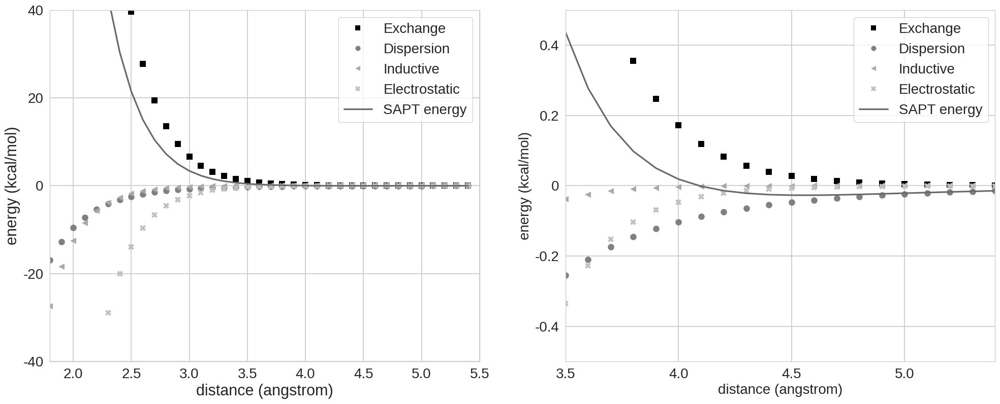

In [ ]:
fig = plt.figure(figsize=(24,9))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)

ax1.plot(distance, exch_energies, 's', color='black', label='Exchange')
ax1.plot(distance, disp_energies, 'o', color='gray', label='Dispersion')
ax1.plot(distance, ind_energies, '<', color='darkgray', label='Inductive')
ax1.plot(distance, elst_energies, 'X', color='silver', label='Electrostatic')
ax1.plot(distance, sapt_energies, '-', color='dimgray', label='SAPT energy')

ax2.plot(distance, exch_energies, 's', color='black', label='Exchange')
ax2.plot(distance, disp_energies, 'o', color='gray', label='Dispersion')
ax2.plot(distance, ind_energies, '<', color='darkgray', label='Inductive')
ax2.plot(distance, elst_energies, 'X', color='silver', label='Electrostatic')
ax2.plot(distance, sapt_energies, '-', color='dimgray', label='SAPT energy')

ax1.set_xlim(1.8, 5.5)
ax1.set_ylim(-40, 40)
ax1.set_xticks(np.arange(2.0, 5.6, 0.5))
ax1.set_xticklabels(np.arange(2.0, 5.6, 0.5), fontsize=fs)
ax1.set_yticks([-40, -20, 0, 20, 40])
ax1.set_yticklabels([-40, -20, 0, 20, 40], fontsize=fs)
ax1.set_xlabel('distance (angstrom)', fontsize=fs+2)
ax1.set_ylabel('energy (kcal/mol)', fontsize=fs+2)
ax1.legend(frameon=True, framealpha=0.8, edgecolor='gray', markerscale=0.8, fontsize=fs)

ax2.set_xlim(3.5, 5.4)
ax2.set_ylim(-0.5, 0.5)
ax2.set_xticks(np.arange(3.5, 5.5, 0.5))
ax2.set_xticklabels(np.arange(3.5, 5.5, 0.5), fontsize=fs)
ax2.set_yticks([-0.4, -0.2, 0, 0.2, 0.4])
ax2.set_yticklabels([-0.4, -0.2, 0, 0.2, 0.4], fontsize=fs)
ax2.set_xlabel('distance (angstrom)', fontsize=fs)
ax2.set_ylabel('energy (kcal/mol)', fontsize=fs)
ax2.legend(frameon=True, framealpha=0.8, edgecolor='gray', markerscale=0.8, fontsize=fs)

fig.savefig('Ar_dimer.png', dpi=600, transparent=True)

In [ ]:
sapt_energies

[544.8988887116882,
 405.3558418531021,
 299.5573532865569,
 219.95345709180526,
 160.5070364419048,
 116.43476290893278,
 83.97983972623473,
 60.226465976723524,
 42.94130490911369,
 30.43360933294158,
 21.43501380221332,
 15.000351352920013,
 10.428746000698107,
 7.202662044281381,
 4.941724135277975,
 3.36797997917645,
 2.2797320299935055,
 1.5317702365480126,
 1.0204524383910325,
 0.6724920268997041,
 0.43657722694479567,
 0.2771406874409956,
 0.16975770659889067,
 0.0977801982575764,
 0.04990980889972424,
 0.01848197692597127,
 -0.0017203651181091834,
 -0.01426917600961864,
 -0.021625472977925466,
 -0.02549276356696706,
 -0.02705218018727015,
 -0.027121020692101726,
 -0.02626158165809791,
 -0.024857129169191073,
 -0.02316540059131543,
 -0.021356623656798218,
 -0.019540402141983697,
 -0.0177847396828977,
 -0.016129359681797763,
 -0.014595034582227644]

#### 分子内SAPT

In [ ]:
psi4.set_options({'fisapt_do_plot': True})

In [ ]:
psi4.set_output_file('F_amide_optfreq.log')

PosixPath('F_amide_optfreq.log')

In [ ]:
F_amide = psi4.geometry('''
0 1
--
0 2
F           -0.093553158280     2.324964836482     0.585518063058
--
0 2
N            1.216832825332     0.111151102067    -0.121273276150
C            2.097014616719    -0.895236359610    -0.477376851950
H            1.607935497543     1.029307131634     0.058500070322
O            1.759722752666    -2.048304337936    -0.716596496883
C            3.539535753825    -0.421437793499    -0.529989277177
H            4.177051536958    -1.269331077145    -0.806622105407
H            3.656548772139     0.382195286724    -1.274166505091
H            3.855967798085    -0.029944686826     0.449766654523
--
0 1
C           -2.340402825232    -1.089090548010     0.013775046564
C           -0.948107683430    -1.137812706500    -0.167344872090
C           -0.176422918755     0.025371485089     0.026707813565
C           -0.847822443334     1.206789616995     0.400514325229
C           -2.224607061003     1.266012037049     0.582312648635
C           -2.983712418679     0.099712942368     0.385972924237
H           -2.924268283231    -2.000484562089    -0.140799963147
H           -0.446052712881    -2.059048267423    -0.456228077052
H           -2.679000144897     2.216069699184     0.872498276667
H           -4.067426888943     0.127458592597     0.524426604897
''')

In [ ]:
_, wfn = optfreq(F_amide, 'mp2/cc-pvdz')

Streaming output truncated to the last 5000 lines.
	   0.000244   0.002256  -0.000337   0.000805  -0.001194   0.002145   0.000922
	  -0.000010   0.000569   0.000516   0.001499   0.002009   0.000725   0.002244
	   0.001166   0.000885   0.001855   0.002834   0.000404   0.359687   0.000021
	   0.000104   0.000158  -0.000118  -0.000531   0.000130   0.001054  -0.000849
	  -0.000325   0.000755   0.000550  -0.000204  -0.000034  -0.000226  -0.000165
	  -0.000593   0.000047   0.000112  -0.000037  -0.000209  -0.000197   0.000137
	   0.000401  -0.000159  -0.000125  -0.000089  -0.000064   0.000246   0.000060
	   0.000153   0.000006   0.000001  -0.000004  -0.000000   0.000137   0.000112
	   0.000213  -0.000002  -0.000002   0.000004   0.000022   0.000016   0.000177
	  -0.000119  -0.000015  -0.000021   0.000140  -0.000156  -0.000181  -0.000080
	  -0.000156   0.000003   0.000005   0.000002  -0.000003  -0.000000  -0.000000
	  -0.000002  -0.000001  -0.000003   0.000000   0.000003   0.000003  -0.000003
	

Optimizer: Optimization complete!


INFO:psi4.driver.task_base:<<< JSON launch ... c1 580.1970415838097
INFO:psi4.driver.task_planner:PLANNING Atomic:  keywords={'SCF__D_CONVERGENCE': 1e-08, 'E_CONVERGENCE': 1e-06, 'SCF__E_CONVERGENCE': 1e-08, 'FISAPT_DO_PLOT': 1, 'FREEZE_CORE': '1', 'GUESS': 'SAD', 'SCF__INTS_TOLERANCE': 1e-12, 'PARENT_SYMMETRY': 'C1', 'SCF_TYPE': 'DF', 'function_kwargs': {}}
INFO:psi4.driver.driver:Compute gradient(): method=mp2, basis=cc-pvdz, molecule=C8FH8NO, nre=580.1970415838097
INFO:psi4.driver.driver:Return gradient(): -537.9859163814873
INFO:psi4.driver.driver:[[-0.00000105  0.00000431  0.00000171]
 [-0.00005277  0.00001577  0.00000419]
 [ 0.00002417 -0.00001425  0.00001506]
 [-0.00001815 -0.00002010 -0.00000356]
 [-0.00006017  0.00000917  0.00000141]
 [ 0.00000241  0.00000125 -0.00000620]
 [-0.00002302  0.00003207  0.00001017]
 [ 0.00000209 -0.00001223  0.00000566]
 [-0.00000195 -0.00000890 -0.00001098]
 [-0.00002160 -0.00002752 -0.00000428]
 [ 0.00003548  0.00001593 -0.00000056]
 [ 0.00004489

 '329.3339' '451.4526' '462.4631' '499.1686' '530.8858' '542.7168'
 '561.7805' '611.0421']


In [ ]:
print(get_freqs(wfn))

[ -11.2025183900421759   48.9625637110187668   82.8235310577042441
  158.4118555839544342  196.6620050307267036  271.2220655236710627
  302.5442962994684990  329.3338732044244352  451.4525877476754090
  462.4631299226498982  499.1686021517713812  530.8857918552756701
  542.7168211866085130  561.7805362245313745  611.0420616023353659
  660.3683889033738978  665.1448849867814488  763.7211214301814834
  812.2283912990154704  848.3350323531531103  858.6607586966314329
  924.8861070232113661  952.9671621910847534  975.3173140831183900
 1006.8317221227021037 1045.8970956266184658 1054.4180151858518002
 1113.8782192581511481 1166.7234460498743829 1211.1064539754734142
 1262.5355419915513266 1287.0351551144999576 1330.4890381359209641
 1385.1487470363317698 1464.8406745667875839 1475.5428792790935404
 1483.0702156327536159 1495.7437558713643284 1523.0039787665839413
 1578.3980647132225386 1652.0412166148203141 1680.0787743975677131
 1798.8738161787871377 3093.0856383421551072 3186.476272420980

In [ ]:
print(F_amide.save_string_xyz_file())

19

 F   -0.109093781832    2.292336931908    0.579469890467
 N    1.210658702709    0.105934656475   -0.119378390790
 C    2.087928551567   -0.882490423985   -0.469511393152
 H    1.594041916377    1.008712749295    0.057360726858
 O    1.765928684381   -2.008185780310   -0.708832457131
 C    3.526623895576   -0.420081391148   -0.529364277570
 H    4.152107025376   -1.262985552778   -0.807519966941
 H    3.639439537738    0.377545669164   -1.266249985396
 H    3.843727271660   -0.033858946023    0.441267486314
 C   -2.326836587953   -1.074189847714    0.015166542072
 C   -0.949148780458   -1.123947424257   -0.163110337642
 C   -0.182381848895    0.022042001381    0.027633551525
 C   -0.847465044281    1.187024310412    0.395180669997
 C   -2.207148590443    1.250200283511    0.574506391316
 C   -2.961847496104    0.100242498460    0.381836532236
 H   -2.904340857669   -1.975591206552   -0.137696119334
 H   -0.464362499084   -2.040199585553   -0.447699029871
 H   -2.654689077899    2.1

In [ ]:
show_3D(F_amide.save_string_xyz_file())

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [ ]:
psi4.set_output_file('F_amide_FISAPT0.log')
psi4.energy('fisapt0/jun-cc-pvdz', molecule=F_amide)

SAPT0
SAPT energy:  2.74
--------------------
Electrostatics term:  2.20
Exchange term:  2.14
Induction term: -0.83
Dispersion term: -0.78


In [ ]:
view = py3Dmol.view()
with open('plot/geom.xyz', 'r') as f:
    geom = f.read()
view.addModel(geom, 'xyz')

with open('plot/DA.cube') as f:
    DA = f.read()

view.addVolumetricData(DA, 'cube',
                       {'isoval': 0.003,
                        'opacity': 0.6})

view.setStyle({'stick': {}})

view.zoomTo()
view.setBackgroundColor('white')
view.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol